In [39]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [4]:
df = pd.read_csv('train.csv')
df.head(5)

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,2.257143,2.213364,2.219783,1.368922,1.066221,1,1.085714,0.433013,0.437059,29.0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,2.257143,1.888175,2.210679,1.557113,1.047221,2,1.128571,0.632456,0.468606,26.0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,2.271429,2.213364,2.232679,1.368922,1.029175,1,1.114286,0.433013,0.444697,19.0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,2.264286,2.213364,2.226222,1.368922,1.048834,1,1.100000,0.433013,0.440952,22.0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,2.242857,2.213364,2.206963,1.368922,1.096052,1,1.057143,0.433013,0.428809,23.0


In [5]:
df.shape

(21263, 82)

In [6]:
df.columns

Index(['number_of_elements', 'mean_atomic_mass', 'wtd_mean_atomic_mass',
       'gmean_atomic_mass', 'wtd_gmean_atomic_mass', 'entropy_atomic_mass',
       'wtd_entropy_atomic_mass', 'range_atomic_mass', 'wtd_range_atomic_mass',
       'std_atomic_mass', 'wtd_std_atomic_mass', 'mean_fie', 'wtd_mean_fie',
       'gmean_fie', 'wtd_gmean_fie', 'entropy_fie', 'wtd_entropy_fie',
       'range_fie', 'wtd_range_fie', 'std_fie', 'wtd_std_fie',
       'mean_atomic_radius', 'wtd_mean_atomic_radius', 'gmean_atomic_radius',
       'wtd_gmean_atomic_radius', 'entropy_atomic_radius',
       'wtd_entropy_atomic_radius', 'range_atomic_radius',
       'wtd_range_atomic_radius', 'std_atomic_radius', 'wtd_std_atomic_radius',
       'mean_Density', 'wtd_mean_Density', 'gmean_Density',
       'wtd_gmean_Density', 'entropy_Density', 'wtd_entropy_Density',
       'range_Density', 'wtd_range_Density', 'std_Density', 'wtd_std_Density',
       'mean_ElectronAffinity', 'wtd_mean_ElectronAffinity',
       'gmean_

In [7]:
df.isnull().sum() #NO MISSING VALUE

number_of_elements       0
mean_atomic_mass         0
wtd_mean_atomic_mass     0
gmean_atomic_mass        0
wtd_gmean_atomic_mass    0
                        ..
range_Valence            0
wtd_range_Valence        0
std_Valence              0
wtd_std_Valence          0
critical_temp            0
Length: 82, dtype: int64

In [8]:
df.corr()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp
number_of_elements,1.000000,-0.141923,-0.353064,-0.292969,-0.454525,0.939304,0.881845,0.682777,-0.320293,0.513998,...,-0.648551,-0.618512,-0.659268,0.967832,0.892559,0.231874,-0.447770,0.105365,0.035216,0.601069
mean_atomic_mass,-0.141923,1.000000,0.815977,0.940298,0.745841,-0.104000,-0.097609,0.125659,0.446225,0.196460,...,0.304683,0.392153,0.321399,-0.156786,-0.145610,-0.107450,0.168633,-0.080279,-0.081253,-0.113523
wtd_mean_atomic_mass,-0.353064,0.815977,1.000000,0.848242,0.964085,-0.308046,-0.412666,-0.144029,0.716623,-0.060739,...,0.545587,0.539780,0.548981,-0.375718,-0.331025,-0.039155,0.330904,-0.003681,0.077323,-0.312272
gmean_atomic_mass,-0.292969,0.940298,0.848242,1.000000,0.856975,-0.190214,-0.232183,-0.175861,0.458473,-0.121708,...,0.427961,0.511508,0.450357,-0.306246,-0.307662,-0.165010,0.272303,-0.124627,-0.117336,-0.230345
wtd_gmean_atomic_mass,-0.454525,0.745841,0.964085,0.856975,1.000000,-0.370561,-0.484664,-0.352093,0.673326,-0.274487,...,0.614100,0.608417,0.623261,-0.477785,-0.448072,-0.078641,0.409674,-0.033313,0.030361,-0.369858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
range_Valence,0.231874,-0.107450,-0.039155,-0.165010,-0.078641,0.203207,0.161350,0.208861,0.023251,0.192347,...,0.111249,-0.041651,0.033007,0.155410,0.204411,1.000000,0.114000,0.973788,0.867393,-0.143546
wtd_range_Valence,-0.447770,0.168633,0.330904,0.272303,0.409674,-0.350047,-0.546910,-0.365395,0.594214,-0.273598,...,0.683700,0.532805,0.681415,-0.417283,-0.639818,0.114000,1.000000,0.184380,0.132162,-0.439901
std_Valence,0.105365,-0.080279,-0.003681,-0.124627,-0.033313,0.087838,0.056309,0.134676,0.066739,0.144106,...,0.186270,0.034589,0.108469,0.034580,0.089774,0.973788,0.184380,1.000000,0.885856,-0.208072
wtd_std_Valence,0.035216,-0.081253,0.077323,-0.117336,0.030361,0.018758,-0.006937,0.102634,0.092819,0.122547,...,0.258593,0.088388,0.168962,-0.017031,0.081284,0.867393,0.132162,0.885856,1.000000,-0.300028


HEATMAP

Text(0.5, 0.98, 'Correlation between all features')

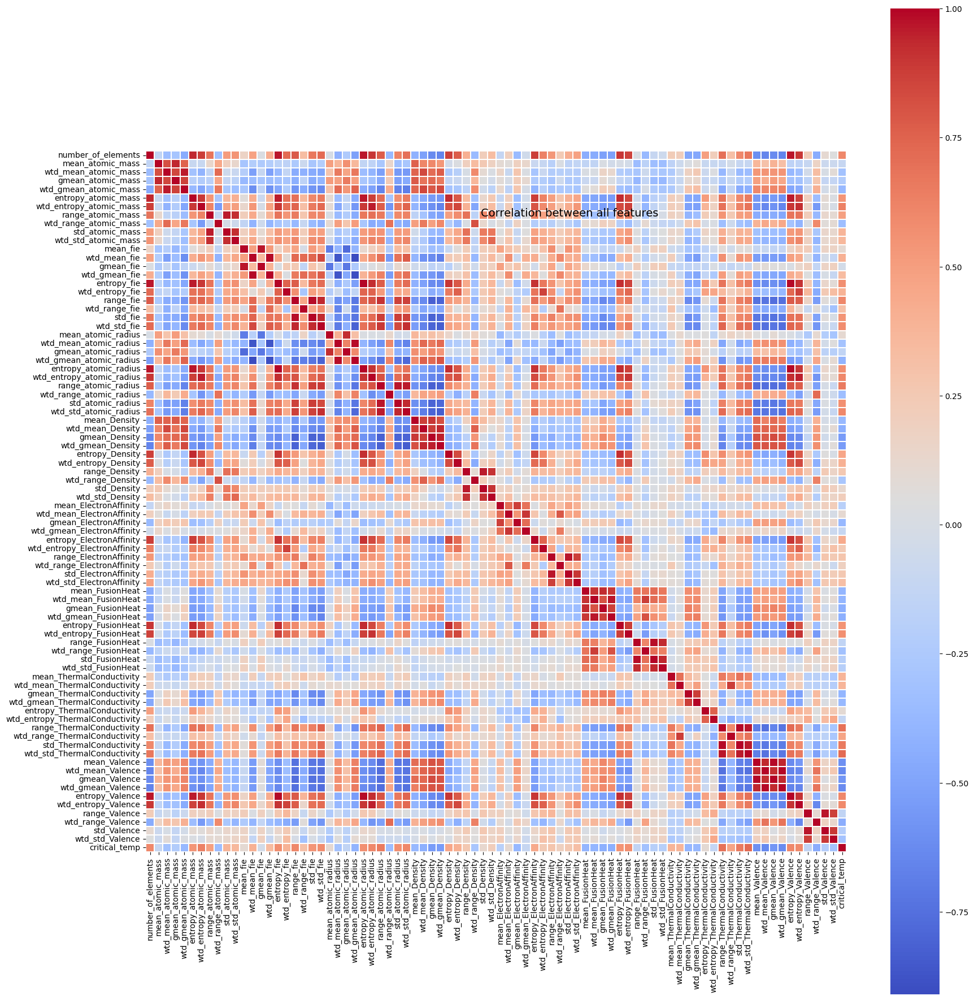

In [58]:
f, ax = plt.subplots(figsize=(20, 16))
corr = np.corrcoef(df.values.T)
rounded_corr = np.round(corr, 2) 
heatmap = sns.heatmap(rounded_corr, ax=ax, cmap="coolwarm", square=True, xticklabels=df.columns, yticklabels=df.columns, linewidth=0.02)
f.subplots_adjust(top=1.2)
f.suptitle('Correlation between all features', fontsize=14)


SELECTING FEATURES WITH HIGHEST CORRELATION

In [9]:
corr_matrix = df.corr()
corr_matrix = corr_matrix['critical_temp'].sort_values(ascending=False)
df=df.dropna()
top_vars = corr_matrix[1:26].index.tolist()
X = df[top_vars]
y = df['critical_temp']
y=y.astype('int')
print(top_vars)

['wtd_std_ThermalConductivity', 'range_ThermalConductivity', 'range_atomic_radius', 'std_ThermalConductivity', 'wtd_entropy_atomic_mass', 'wtd_entropy_atomic_radius', 'number_of_elements', 'range_fie', 'wtd_std_atomic_radius', 'entropy_Valence', 'wtd_entropy_Valence', 'wtd_std_fie', 'entropy_fie', 'wtd_entropy_FusionHeat', 'std_atomic_radius', 'entropy_atomic_radius', 'entropy_FusionHeat', 'entropy_atomic_mass', 'std_fie', 'range_atomic_mass', 'wtd_range_ThermalConductivity', 'entropy_Density', 'entropy_ElectronAffinity', 'wtd_entropy_Density', 'wtd_mean_fie']


Text(0.5, 0.98, 'Correlation between all features')

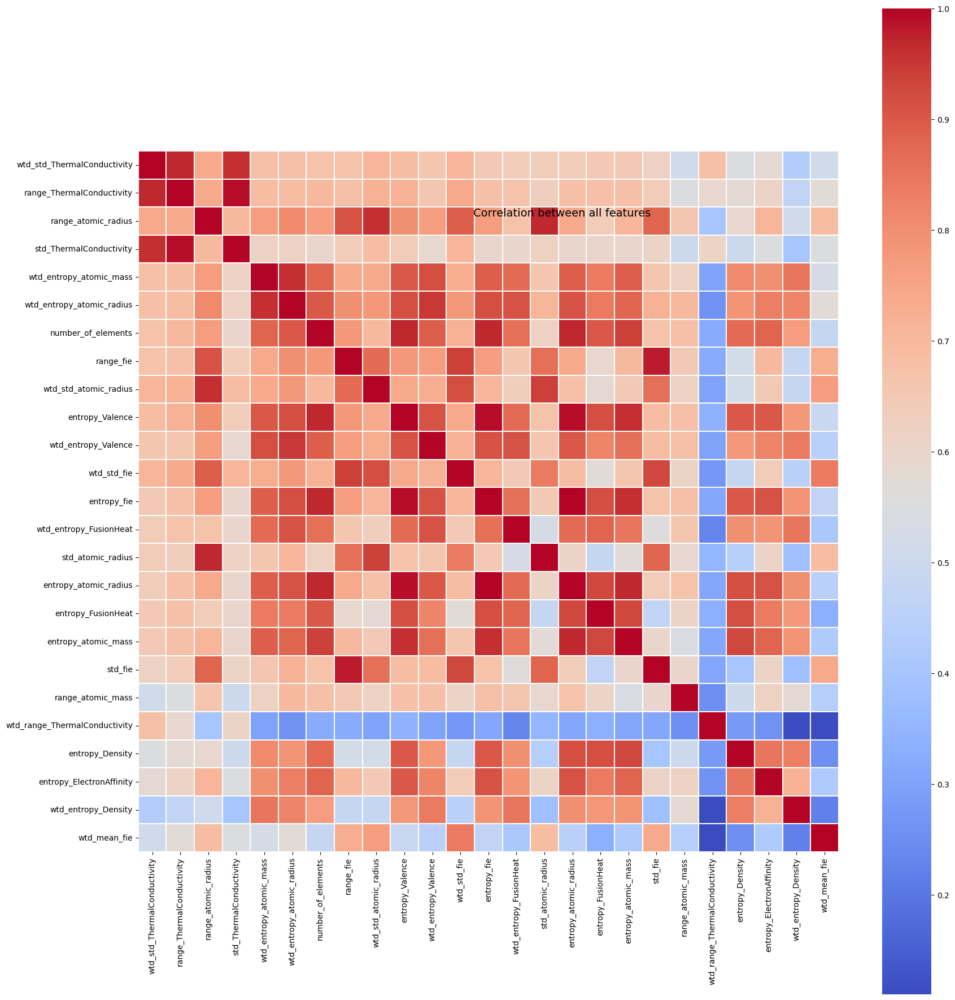

In [79]:
f, ax = plt.subplots(figsize=(20, 16))
corr = np.corrcoef(df[top_vars].values.T)
rounded_corr = np.round(corr, 2) 
heatmap = sns.heatmap(rounded_corr, ax=ax, cmap="coolwarm", square=True, xticklabels=df[top_vars].columns, yticklabels=df[top_vars].columns, linewidth=0.02)
f.subplots_adjust(top=1.2)
f.suptitle('Correlation between all features', fontsize=14)


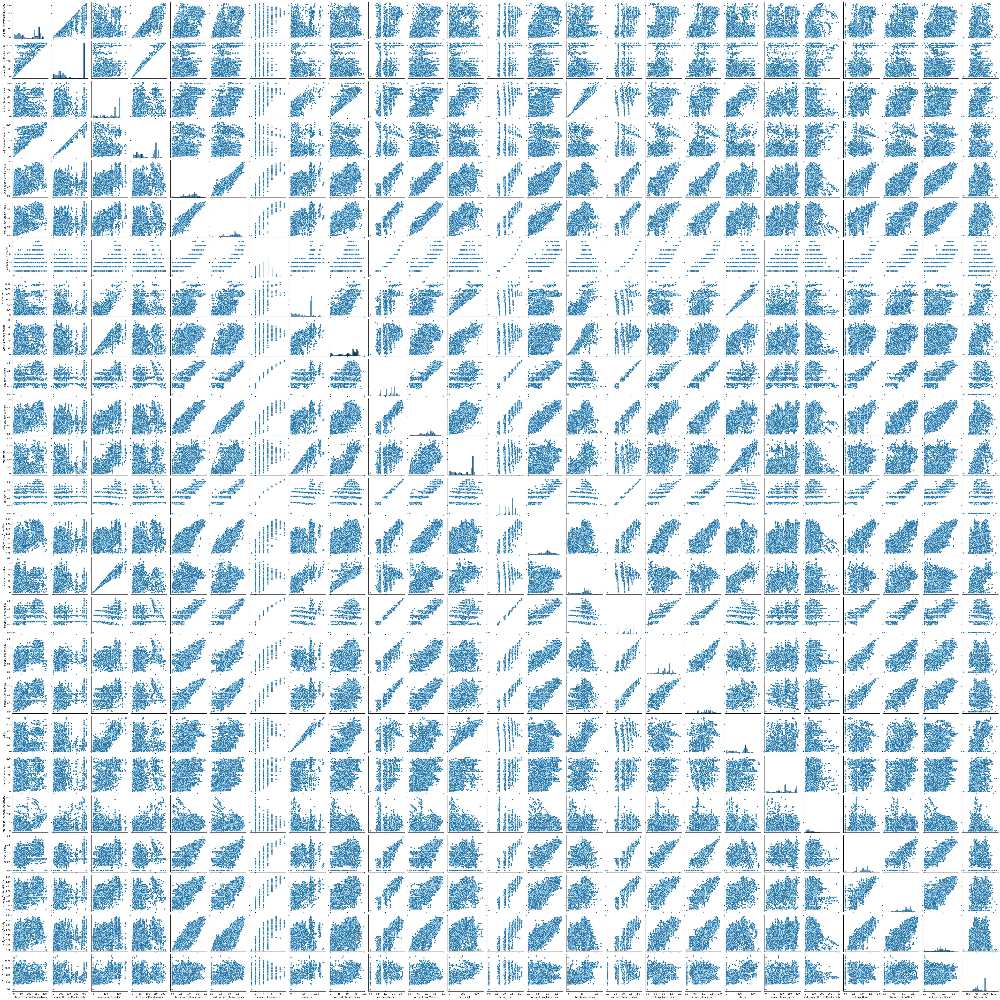

In [69]:
sns.pairplot(df[top_vars])

TEST - TRAIN SPLIT

In [63]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_train, X_test, y_train, y_test = train_test_split
(X_scaled, y, test_size=0.20, random_state=42)

LINEAR REGRESSION 

In [72]:
linear_regression = LinearRegression()

linear_regression.fit(X_train, y_train)

y_train_pred = linear_regression.predict(X_train)
y_test_pred = linear_regression.predict(X_test)

print('MSE Train : %.3f, Test : %.3f' % 
      (mean_squared_error(y_train, y_train_pred),                 
        mean_squared_error(y_test, y_test_pred)))

train_r2_lr = r2_score(y_train, y_train_pred)
linearRegression_r2_test = r2_score(y_test, y_test_pred)

print('R^2 Score Train: %.3f, Test : %.3f'
 % (linearRegression_r2_train, linearRegression_r2_test))

MSE Train : 399.755, Test : 377.623
R^2 Score Train: 0.663, Test : 0.674


RANDOM FOREST REGRESSOR

In [73]:
forest = RandomForestRegressor(n_estimators=1000, 
                               criterion='squared_error',
                               random_state=1,
                               n_jobs=-1)  

forest.fit(X_train, y_train)

y_train_pred = forest.predict(X_train)
y_test_pred = forest.predict(X_test)

print('MSE Train : %.3f, Test : %.3f' %
       (mean_squared_error(y_train, y_train_pred),
         mean_squared_error(y_test, y_test_pred)))

train_r2_rf = r2_score(y_train, y_train_pred)
RandomForestRegressor_r2_test = r2_score(y_test,
                                 y_test_pred)

print('R^2 Score Train: %.3f, Test : %.3f' %
       (RandomForestRegressor_r2_train, 
        RandomForestRegressor_r2_test))

MSE Train : 26.480, Test : 83.948
R^2 Score Train: 0.978, Test : 0.927


DECISION TREE 

In [75]:
decision_tree = DecisionTreeRegressor()

decision_tree.fit(X_train, y_train)

y_train_pred = decision_tree.predict(X_train)
y_test_pred = decision_tree.predict(X_test)

print('MSE Train : %.3f, Test : %.3f' % 
      (mean_squared_error(y_train, y_train_pred),
      mean_squared_error(y_test, y_test_pred)))

train_r2_dt = r2_score(y_train, y_train_pred)
DecisionTreeRegressor_r2_test = r2_score(y_test,
                                 y_test_pred)

print('R^2 Score Train: %.3f, Test : %.3f' % 
      (DecisionTreeRegressor_r2_train,
        DecisionTreeRegressor_r2_test))

MSE Train : 17.554, Test : 149.394
R^2 Score Train: 0.985, Test : 0.871


Training comparison

In [76]:
rms_vals = [train_r2_lr ,train_r2_dt, train_r2_rf]
labels = ['Linear', 'Descision Tree','Random Forest']
rms_df = pd.Series(rms_vals, index=labels).to_frame()
rms_df.rename(columns={0: 'R2 Score Training'}, inplace=1)
rms_df

,R2 Score Training
Linear,0.662524
Descision Tree,0.985180
Random Forest,0.977645


Testing comparison

In [70]:
rms_vals = [linearRegression_r2_test ,DecisionTreeRegressor_r2_test, RandomForestRegressor_r2_test]

labels = ['Linear', 'Descision Tree','Random Forest']

rms_df = pd.Series(rms_vals, index=labels).to_frame()
rms_df.rename(columns={0: 'R2 Score Testing'}, inplace=1)
rms_df

,R2 Score Testing
Linear,0.673513
Descision Tree,0.867047
Random Forest,0.927420


HYPERPARAMTER TUNING

RANDOM FOREST

In [68]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

rf = RandomForestRegressor()

grid_search = GridSearchCV(estimator=rf, 
param_grid=param_grid, cv=5, scoring='r2')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

y_train_pred_rf = best_model.predict(X_train)
y_test_pred_rf = best_model.predict(X_test)

train_r2_rf = r2_score(y_train, y_train_pred_rf)
test_r2_rf = r2_score(y_test, y_test_pred_rf)

print("Best Parameters:", best_params)
print("R-squared Score on Training Data:", train_r2_rf)
print("R-squared Score on Testing Data:", test_r2_rf)


Best Parameters: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
R-squared Score on Training Data: 0.9775390387039136
R-squared Score on Testing Data: 0.9269122438180203


DECISION TREE REGRESSOR

In [74]:
param_grid_dt = {
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

dt = DecisionTreeRegressor()

grid_search_dt = GridSearchCV(estimator=dt, 
param_grid=param_grid_dt, cv=5, scoring='r2')
grid_search_dt.fit(X_train, y_train)

best_params_dt = grid_search_dt.best_params_
best_model_dt = grid_search_dt.best_estimator_

# Predictions on training and testing data
y_train_pred_dt = best_model_dt.predict(X_train)
y_test_pred_dt = best_model_dt.predict(X_test)

# Evaluate performance
train_r2_dt = r2_score(y_train, y_train_pred_dt)
test_r2_dt = r2_score(y_test, y_test_pred_dt)

# Print results
print("Best Parameters (Decision Tree):", best_params_dt)
print("R-squared Score on Training Data (Decision Tree):", train_r2_dt)
print("R-squared Score on Testing Data (Decision Tree):", test_r2_dt)

Best Parameters (Decision Tree): {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 10}
R-squared Score on Training Data (Decision Tree): 0.9564499639058426
R-squared Score on Testing Data (Decision Tree): 0.8722030614751872


LINEAR REGRESSION

In [93]:


param_grid_lr = {
    'fit_intercept': [True, False],
    'copy_X': [True, False]
}

# Initialize
lr = LinearRegression()

# Perform Grid Search with cross-validation
grid_search_lr = GridSearchCV(estimator=lr,      
param_grid=param_grid_lr, cv=5, scoring='r2')
grid_search_lr.fit(X_train, y_train)

# Get the best parameters and best model from Grid Search
best_params_lr = grid_search_lr.best_params_
best_model_lr = grid_search_lr.best_estimator_

# Predictions on training and testing data
y_train_pred_lr = best_model_lr.predict(X_train)
y_test_pred_lr = best_model_lr.predict(X_test)

# Evaluate performance
train_r2_lr = r2_score(y_train, y_train_pred_lr)
test_r2_lr = r2_score(y_test, y_test_pred_lr)

# Print results
print("Best Parameters (Linear Regression):", best_params_lr)
print("R-squared Score on Training Data (Linear Regression):", train_r2_lr)
print("R-squared Score on Testing Data (Linear Regression):", test_r2_lr)


Best Parameters (Linear Regression): {'copy_X': True, 'fit_intercept': True}
R-squared Score on Training Data (Linear Regression): 0.6625237330816427
R-squared Score on Testing Data (Linear Regression): 0.6735128242009933


Training comparison

In [85]:
rms_vals = [train_r2_lr ,train_r2_dt, train_r2_rf]
labels = ['Linear', 'Descision Tree','Random Forest']
rms_df = pd.Series(rms_vals, index=labels).to_frame()
rms_df.rename(columns={0: 'R2 Score Training'}, inplace=1)
rms_df

,R2 Score Training
Linear,0.662524
Descision Tree,0.956450
Random Forest,0.977539


Testing comparison

In [84]:
rms_vals = [test_r2_lr ,test_r2_dt, test_r2_rf]
labels = ['Linear', 'Descision Tree','Random Forest']
rms_df = pd.Series(rms_vals, index=labels).to_frame()
rms_df.rename(columns={0: 'R2 Score Testing'}, inplace=1)
rms_df

,R2 Score Testing
Linear,0.673513
Descision Tree,0.872203
Random Forest,0.926912


RandomForestRegressor [ACTUAL VS PREDICTED]

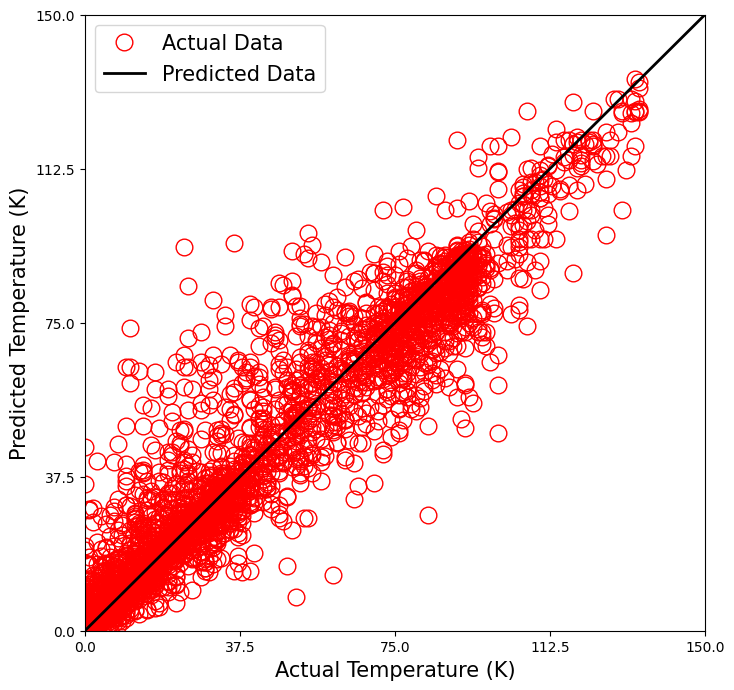

In [79]:

plt.figure(1, figsize=(8, 8))
plt.plot(y_test, y_test_pred_rf, 'ro', markersize=12, mfc='none')
plt.plot([0, 150], [0, 150], 'k', linewidth=2)
plt.xlabel('Actual Temperature (K)', fontsize=15)
plt.ylabel('Predicted Temperature (K)', fontsize=15)
plt.xlim((0, 150))
plt.ylim((0, 150))
ticks = np.linspace(0, 150, 5)
plt.xticks(ticks)
plt.yticks(ticks)
plt.legend(['Actual Data', 'Predicted Data'], loc='best', fontsize=15)
plt.show()


DecisionTreeRegressor [ACTUAL VS PREDICTED]

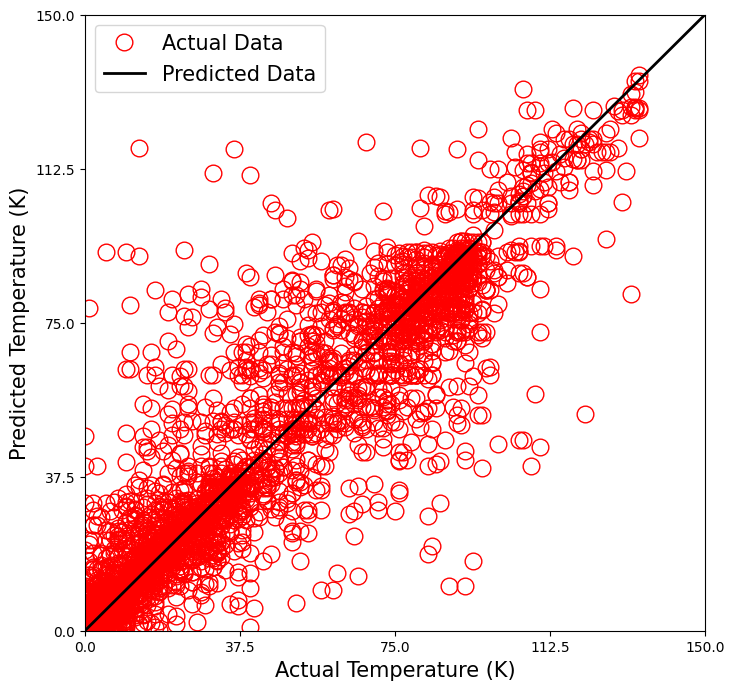

In [80]:
plt.figure(1, figsize=(8,8))
plt.plot(y_test, y_test_pred_dt, 'ro', markersize=12, mfc='none')
plt.plot([0,150],[0,150],'k', linewidth = 2)
plt.xlabel('Actual Temperature (K)', fontsize = 15)
plt.ylabel('Predicted Temperature (K)', fontsize = 15)
plt.xlim((0,150))
plt.ylim((0,150))
ticks = np.linspace(0,150,5)
text = r'$\pm'+str(8.9674)+'$'+'K \n = 0.924'
plt.xticks(ticks)
plt.yticks(ticks)
plt.legend(['Actual Data', 'Predicted Data'], loc='best', fontsize=15)

LinearRegression [ACTUAL VS PREDICTED]

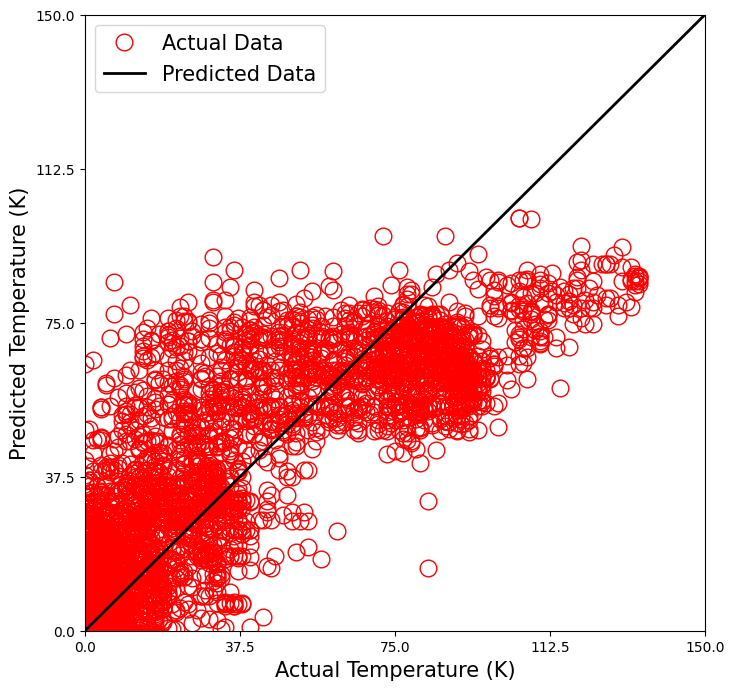

In [81]:
plt.figure(1, figsize=(8,8))
plt.plot(y_test, y_test_pred_lr, 'ro', markersize=12, mfc='none')
plt.plot([0,150],[0,150],'k', linewidth = 2)
plt.xlabel('Actual Temperature (K)', fontsize = 15)
plt.ylabel('Predicted Temperature (K)', fontsize = 15)
plt.xlim((0,150))
plt.ylim((0,150))
ticks = np.linspace(0,150,5)
plt.xticks(ticks)
plt.yticks(ticks)
plt.legend(['Actual Data', 'Predicted Data'], loc='best', fontsize=15)